In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from geopy.distance import geodesic
from shapely.geometry import Point
import json

In [2]:
wards = gpd.read_file('../Data/Raw/bangalore_wards.json')
df = pd.read_csv('../Data/Raw/bangalore_aggregate.csv')

In [3]:
df.head()

,sourceid,dstid,hod,mean_travel_time,standard_deviation_travel_time,geometric_mean_travel_time,geometric_standard_deviation_travel_time
0,55,111,8,2026.76,639.03,1942.16,1.33
1,22,25,13,770.07,378.42,700.64,1.51
2,163,16,14,3151.78,674.41,3092.38,1.21
3,162,26,14,3093.64,613.05,3046.00,1.18
4,23,15,13,2835.28,527.41,2789.81,1.19


In [4]:
wards.head()

,WARD_NO,WARD_NAME,MOVEMENT_ID,DISPLAY_NAME,geometry
0,2,Chowdeswari Ward,1,"Unnamed Road, Bengaluru","MULTIPOLYGON (((77.59229 13.0972, 77.59094 13...."
1,3,Atturu,2,"9th Cross Bhel Layout, Adityanagar, Vidyaranya...","MULTIPOLYGON (((77.56862 13.12705, 77.57064 13..."
2,4,Yelahanka Satellite Town,3,"15th A Cross Road, Yelahanka Satellite Town, Y...","MULTIPOLYGON (((77.59094 13.09842, 77.59229 13..."
3,51,Vijnanapura,4,"SP Naidu Layout 4th Cross Street, SP Naidu Lay...","MULTIPOLYGON (((77.67683 13.01147, 77.67695 13..."
4,53,Basavanapura,5,"Medahalli Kadugodi Road, Bharathi Nagar, Krish...","MULTIPOLYGON (((77.72899 13.02061, 77.72994 13..."


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 818262 entries, 0 to 818261
Data columns (total 7 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   sourceid                                  818262 non-null  int64  
 1   dstid                                     818262 non-null  int64  
 2   hod                                       818262 non-null  int64  
 3   mean_travel_time                          818262 non-null  float64
 4   standard_deviation_travel_time            818262 non-null  float64
 5   geometric_mean_travel_time                818262 non-null  float64
 6   geometric_standard_deviation_travel_time  818262 non-null  float64
dtypes: float64(4), int64(3)
memory usage: 43.7 MB


### Converting to PLANAR CRS

In [6]:
# Step 1: Project to UTM 43N (meters)
wards_utm = wards.to_crs(epsg=32643)

# Step 2: Compute centroid in projected CRS (safe)
wards_utm['centroid'] = wards_utm.geometry.centroid

# Step 3: Convert centroids back to lat/lon
wards_utm = wards_utm.to_crs(epsg=4326)

# Step 4: Extract coordinates
wards_utm['lat'] = wards_utm.centroid.y
wards_utm['lon'] = wards_utm.centroid.x

# Step 5: Keep only what you need
centroids = wards_utm[['WARD_NO', 'lat', 'lon']]

C:\Users\ayush\AppData\Local\Temp\ipykernel_18144\2346242838.py:11: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  wards_utm['lat'] = wards_utm.centroid.y
C:\Users\ayush\AppData\Local\Temp\ipykernel_18144\2346242838.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  wards_utm['lon'] = wards_utm.centroid.x


In [7]:


df['sourceid'] = df['sourceid'].astype(str)
df['dstid'] = df['dstid'].astype(str)
wards['WARD_NO'] = wards['WARD_NO'].astype(str)

df = df.merge(centroids, left_on='sourceid', right_on='WARD_NO', how='left')
df = df.merge(centroids, left_on='dstid', right_on='WARD_NO', suffixes=('_src', '_dst'))


In [8]:

lat1 = np.radians(df['lat_src'])
lon1 = np.radians(df['lon_src'])
lat2 = np.radians(df['lat_dst'])
lon2 = np.radians(df['lon_dst'])

# Haversine formula
R = 6371  # Earth radius in km
df['distance_km'] = 2 * R * np.arcsin(
    np.sqrt(
        np.sin((lat2 - lat1) / 2)**2 +
        np.cos(lat1) * np.cos(lat2) * np.sin((lon2 - lon1) / 2)**2
    )
)
df['rush_hour'] = df['hod'].apply(lambda x: 1 if 8 <= x <= 10 or 17 <= x <= 20 else 0)
df['fare_est'] = 40 + df['distance_km'] * 12

<Axes: >

c:\Users\ayush\OneDrive\Desktop\Evrything\Workspace\Pandas\venv\Lib\site-packages\IPython\core\events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
c:\Users\ayush\OneDrive\Desktop\Evrything\Workspace\Pandas\venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


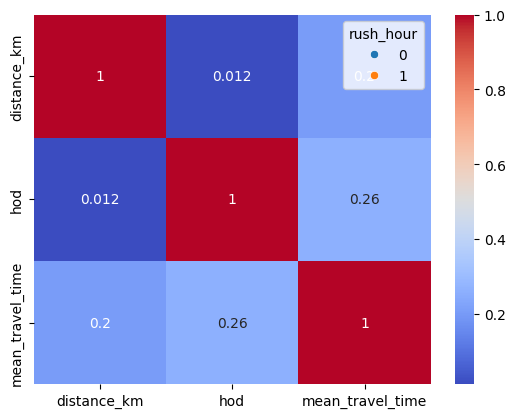

In [9]:
sns.histplot(df['mean_travel_time'], bins=50)
sns.scatterplot(x='distance_km', y='mean_travel_time', data=df, hue='rush_hour')
sns.heatmap(df[['distance_km','hod','mean_travel_time']].corr(), annot=True, cmap='coolwarm')

In [10]:
df.to_csv('../Data/Cleaned/Cleaned_Data.csv')
wards.to_file("../Data/Cleaned/cleaned_bangalore_wards.geojson", driver="GeoJSON")

In [11]:
import plotly.express as px
import plotly
import nbformat
print(plotly.__version__, nbformat.__version__)


# ensure key types match
df['sourceid'] = df['sourceid'].astype(str)

fig = px.choropleth_map(
    df,
    geojson="../data/processed/cleaned_bangalore_wards.geojson",
    locations="sourceid",
    featureidkey="properties.WARD_NO",
    color="mean_travel_time",
    color_continuous_scale="YlOrRd",
    range_color=(df['mean_travel_time'].min(), df['mean_travel_time'].max()),
    map_style="carto-positron",
    center={"lat": 12.97, "lon": 77.59},
    zoom=10.5,
    opacity=0.7,
    labels={"mean_travel_time": "Avg Travel Time (sec)"}
)

fig.update_layout(
    title="Bangalore Ward-wise Average Travel Time",
    title_x=0.5,
    margin={"r":0, "t":40, "l":0, "b":0}
)

fig.show()


6.4.0 5.10.4
